<a href="https://colab.research.google.com/github/agmarrugo/computer-vision-utb/blob/main/notebooks/camera_calibration.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Camera calibration

Andres Marrugo, PhD    
Universidad Tecnológica de Bolívar  

We will calibrate a camera with openCV. We will use the default dataset in opencv (`samples/data/left01.jpg-left14.jpg`) and our own data set.

![](https://github.com/agmarrugo/computer-vision-utb/raw/main/figures/camera-calibration.gif)

Before following this notebook, check the  [OpenCV camera calibration tutorial](https://docs.opencv.org/3.4.15/dc/dbb/tutorial_py_calibration.html "OpenCV: Camera Calibration").


In [18]:
# Let's import the necessary libraries
import numpy as np
import cv2 as cv
import cv2
import matplotlib.pylab as plt
from google.colab.patches import cv2_imshow # for image display
import glob
from skimage import io
import urllib.request

First let's download the images. This is a svn trick with Github that will let you download all images from a folder.

In [9]:
!apt install subversion
!svn checkout https://github.com/agmarrugo/computer-vision-utb/trunk/data/calib_data/

Reading package lists... Done
Building dependency tree       
Reading state information... Done
subversion is already the newest version (1.9.7-4ubuntu1).
0 upgraded, 0 newly installed, 0 to remove and 37 not upgraded.
Checked out revision 58.


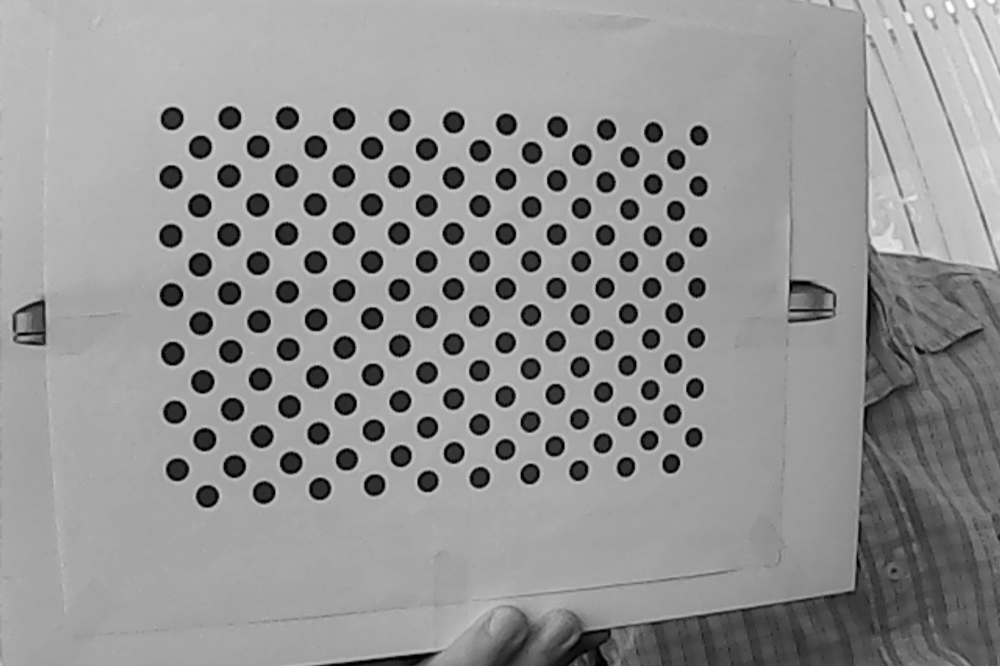

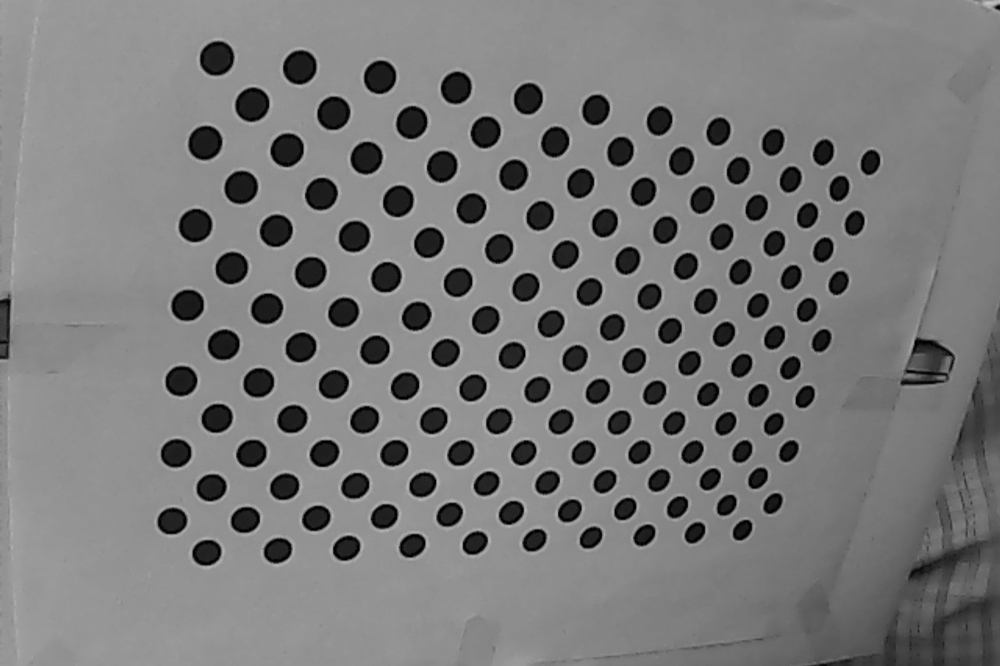

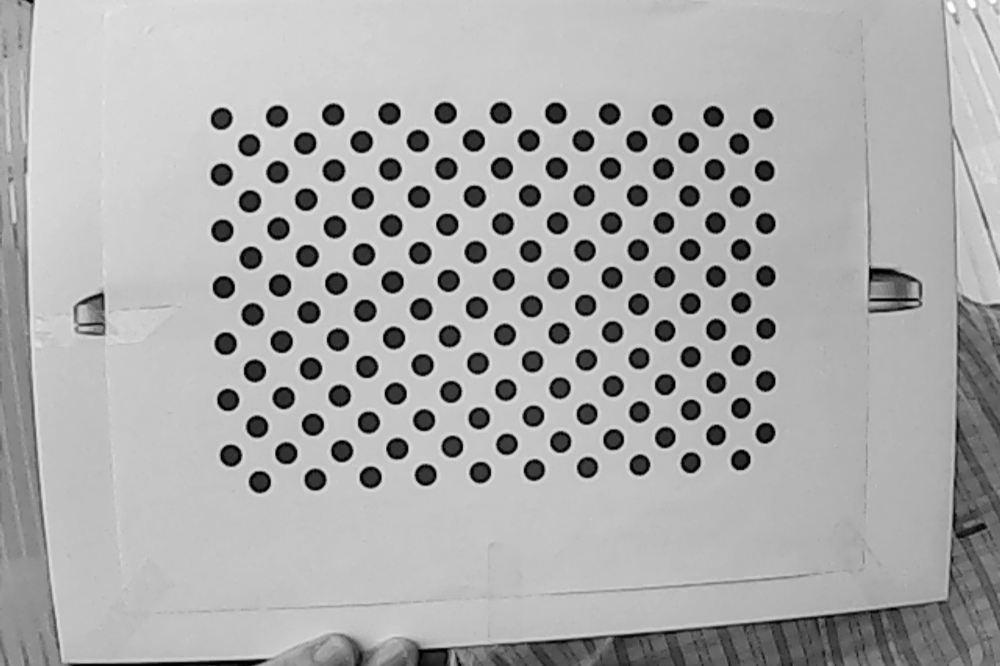

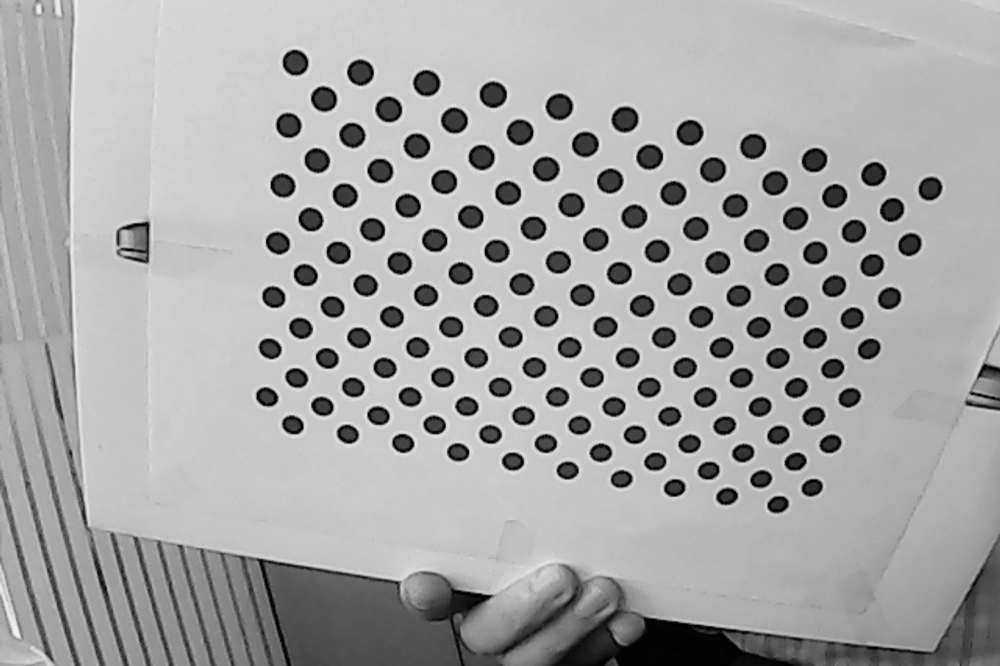

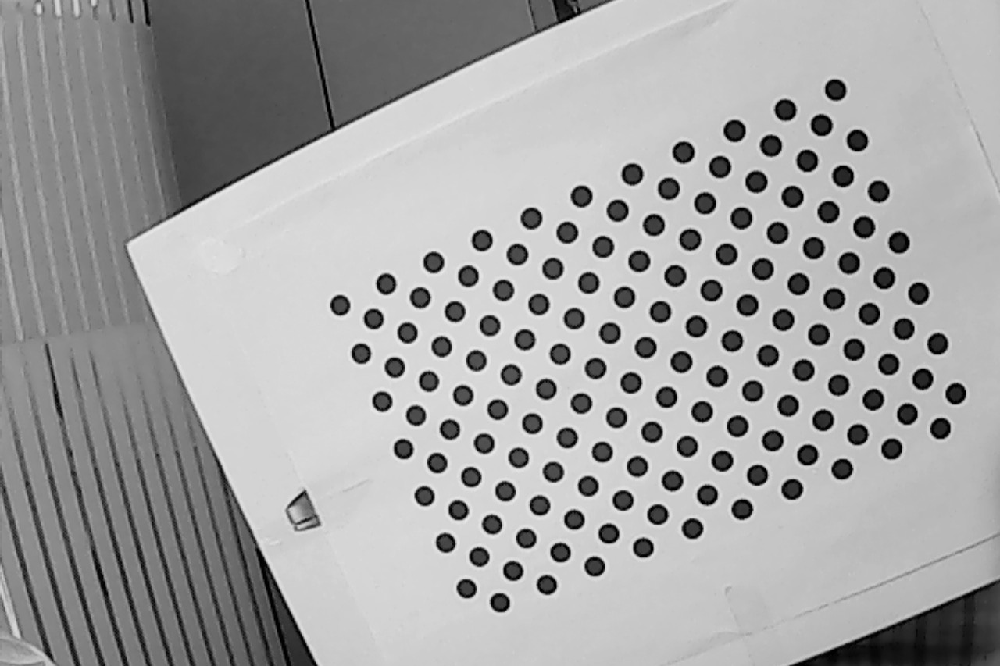

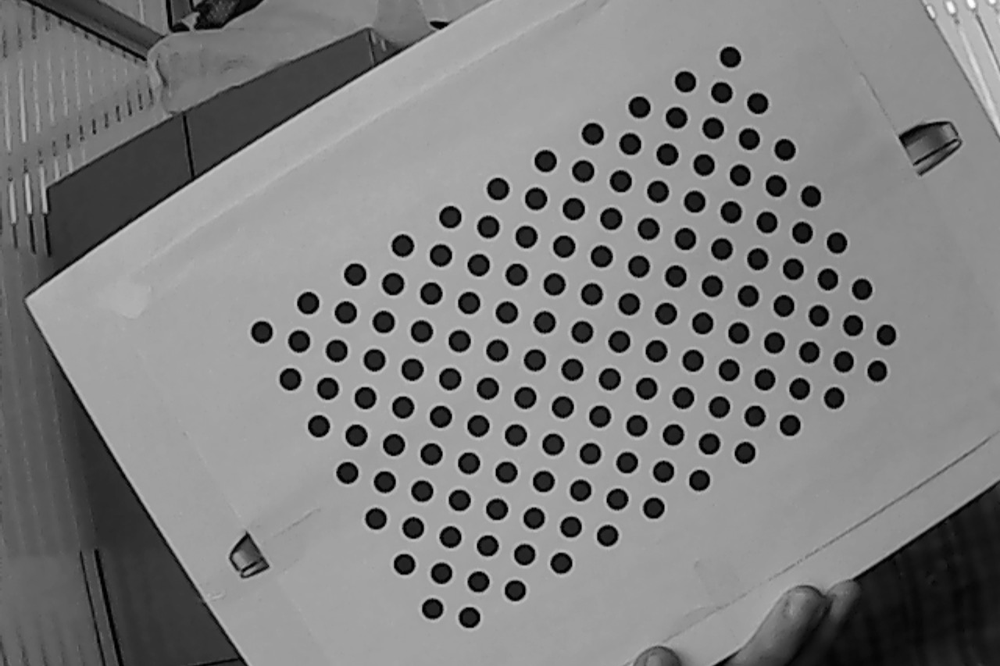

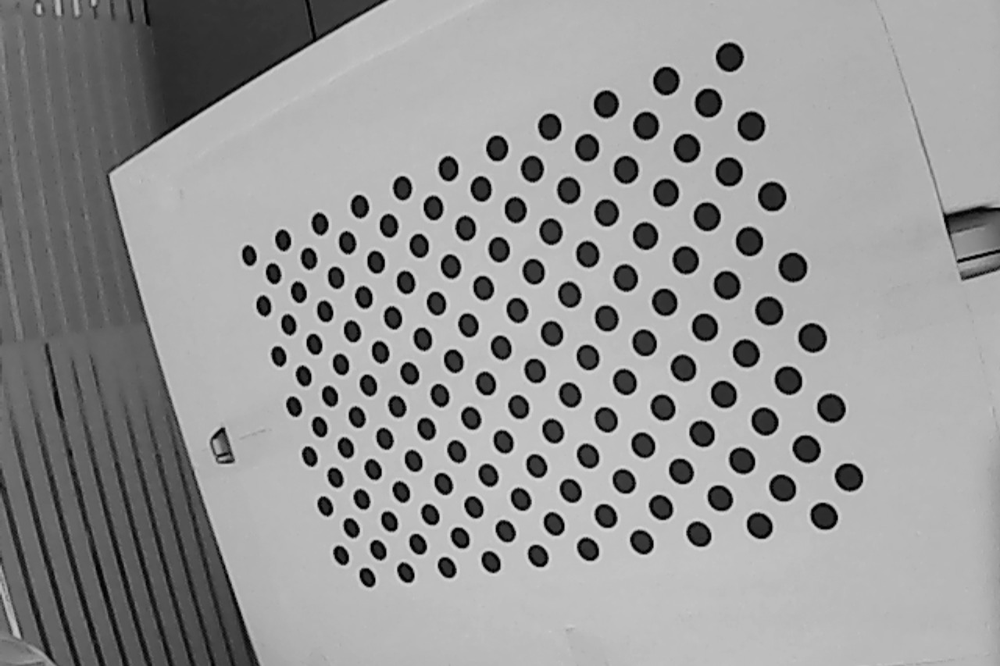

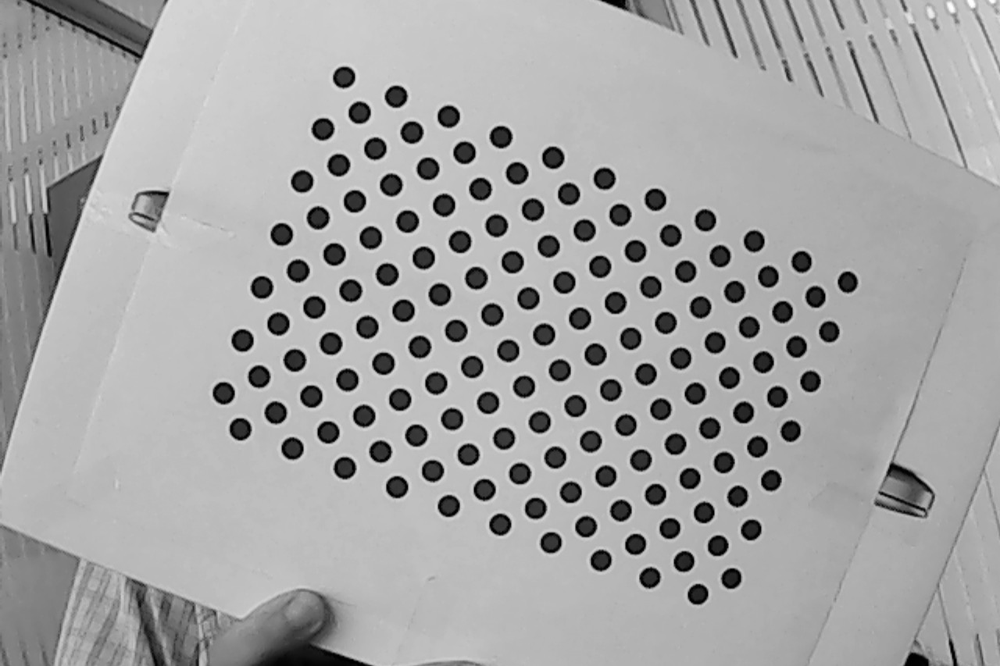

In [7]:
# Let's display the images

images = glob.glob('calib_data/*.jpg')
for fname in images:
    img = cv.imread(fname)
    gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
    cv2_imshow(gray)


=== Camera Calibration ===
Finding pattern circle centers in input images ...
calib_data/pose_06.jpg


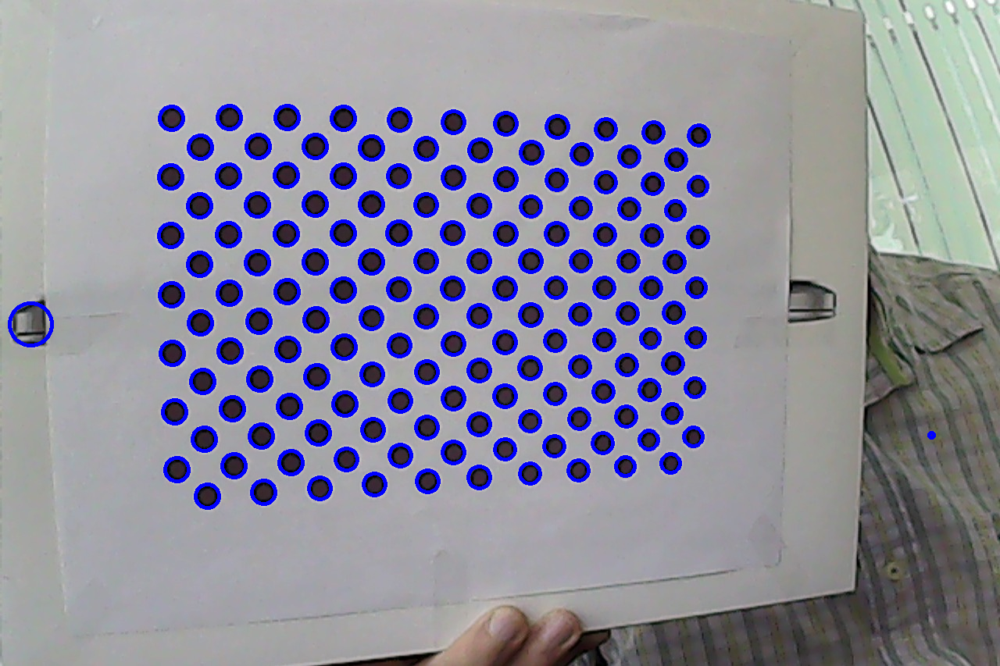

Found


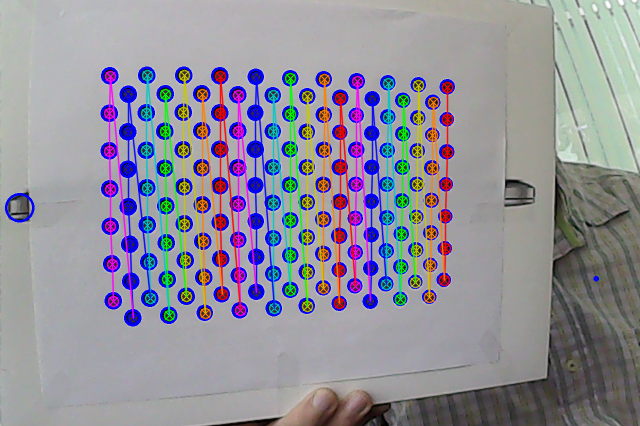

calib_data/pose_03.jpg


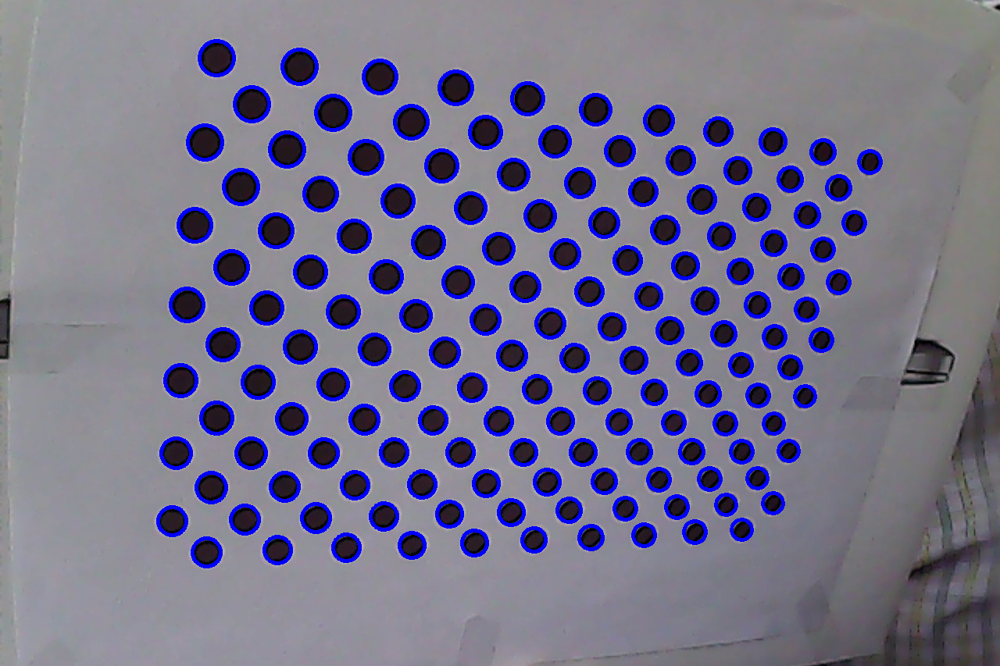

Found


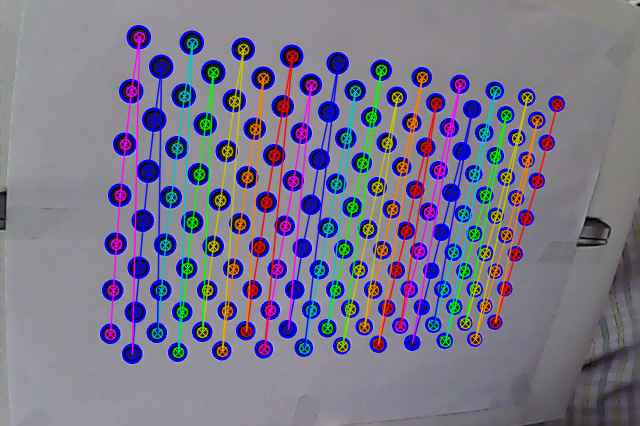

calib_data/pose_02.jpg


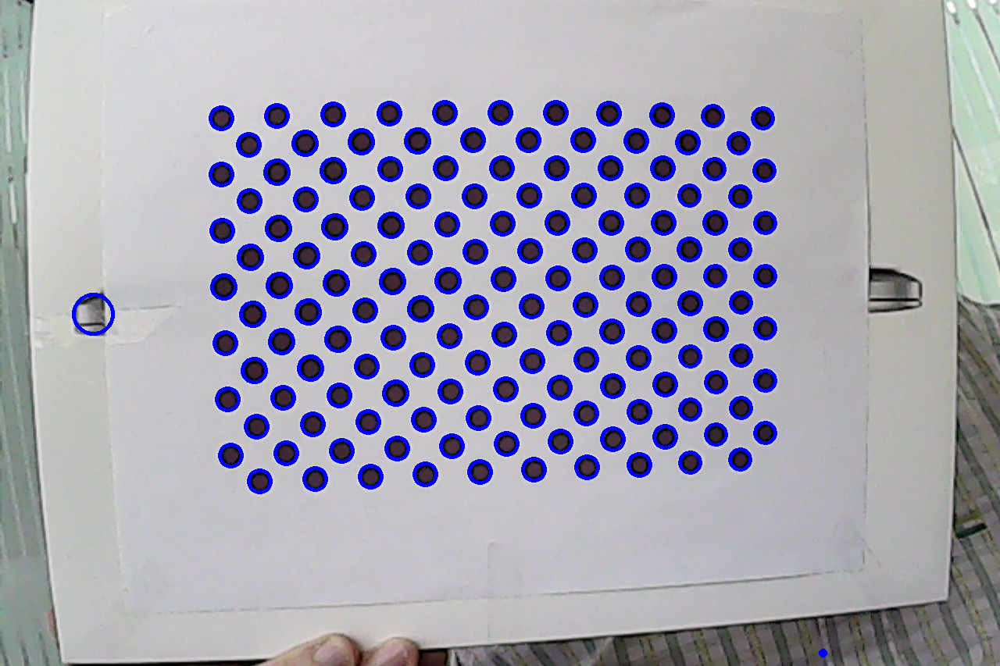

Found


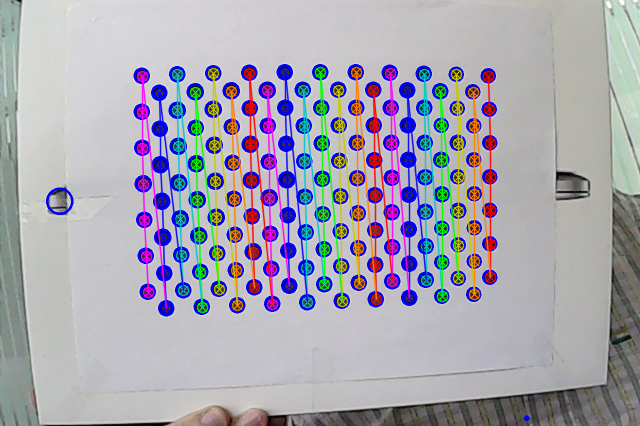

calib_data/pose_05.jpg


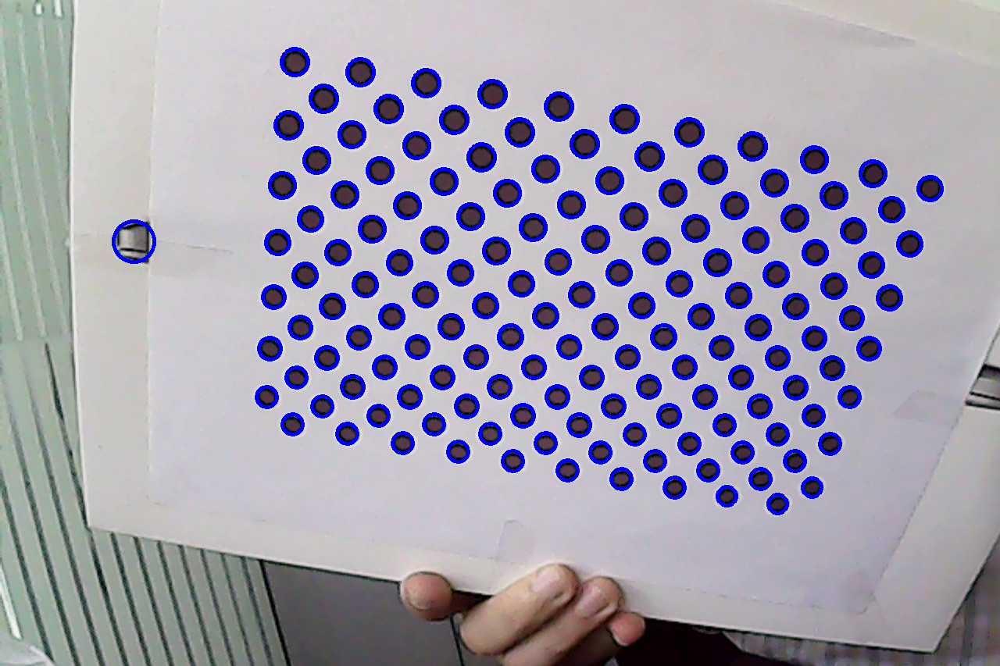

Found


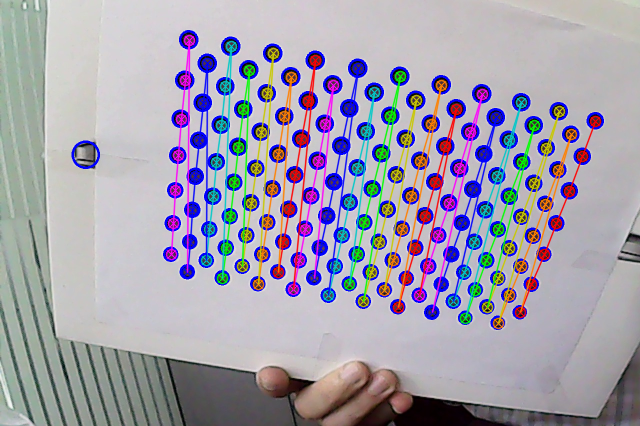

calib_data/pose_07.jpg


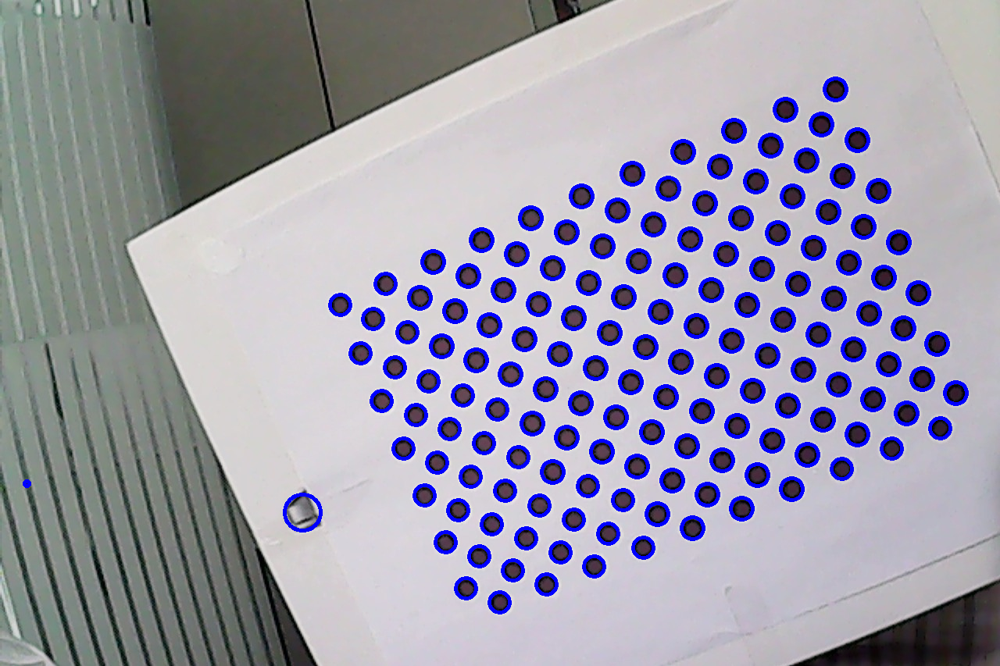

Found


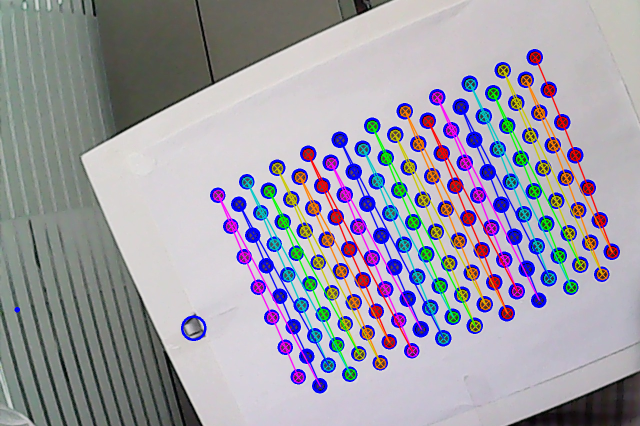

calib_data/pose_01.jpg


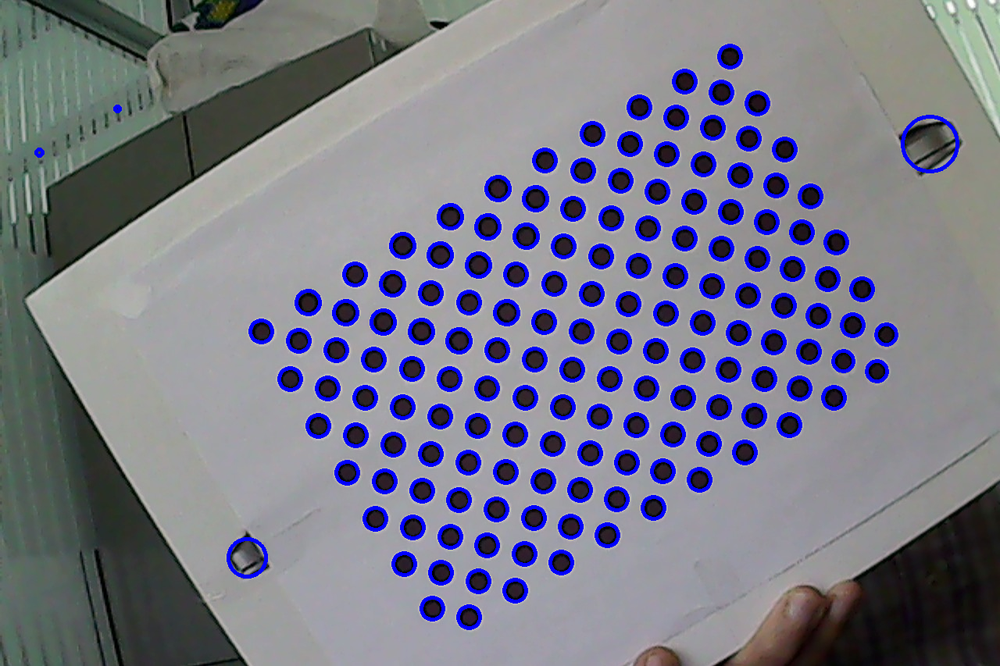

Found


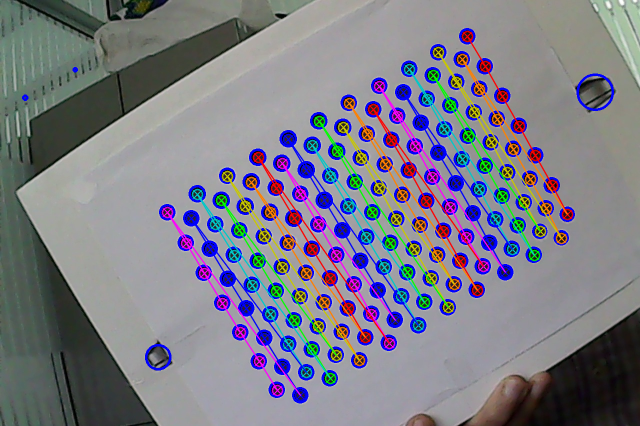

calib_data/pose_04.jpg


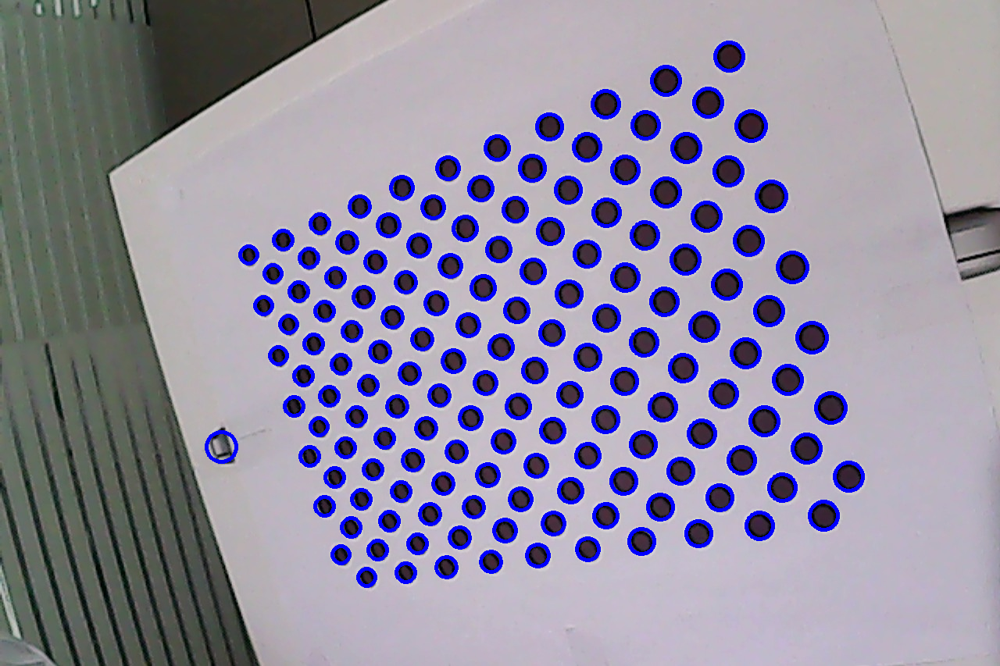

Found


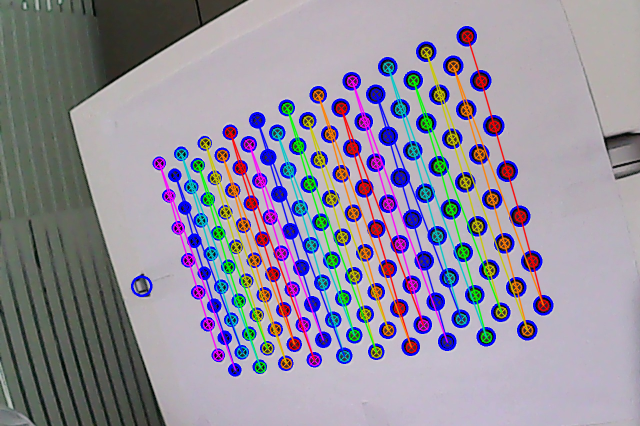

calib_data/pose_00.jpg


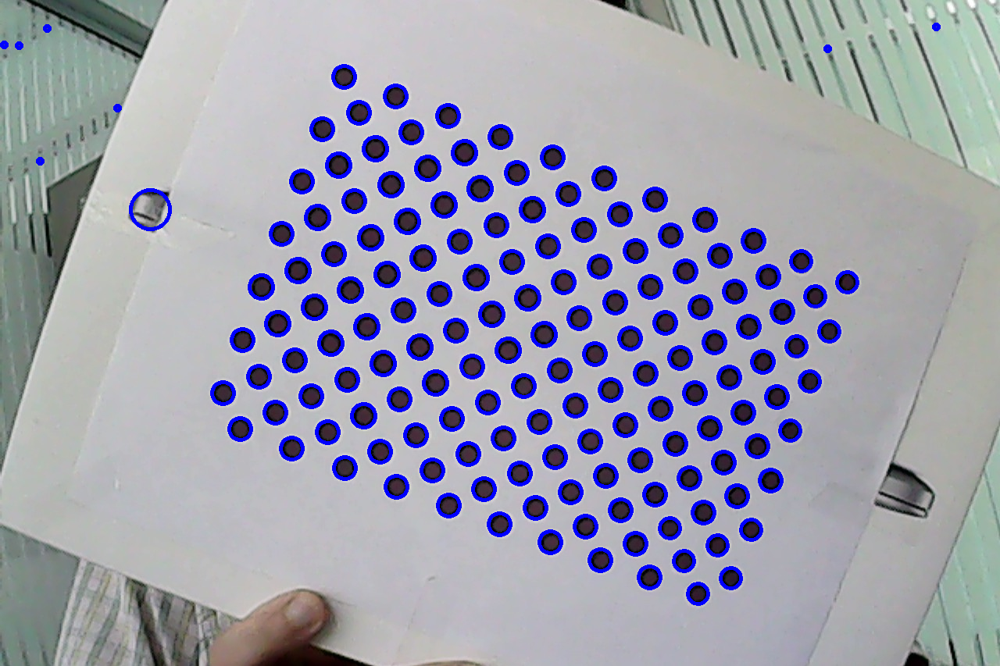

Found


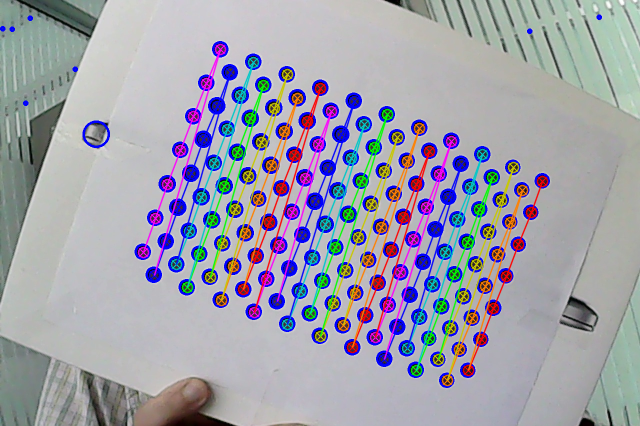

In [12]:
# This is the calibration code.
# It first loads the images, then it detects the grid pattern.

# Necessary input parameters
pattern_shape = (7, 21)
marker_size = 10

print('=== Camera Calibration ===')

DISPLAY_BLOBS = True

# Defining world object points
k = 0;
objp = np.zeros((pattern_shape[0]*pattern_shape[1], 3), np.float32)
for i in range(pattern_shape[1]):
    for j in range(pattern_shape[0]):
        objp[k] = np.array([(2.0*j+np.mod(i,2))*marker_size, i*marker_size, 0])
        k += 1

# blob detector 
params = cv2.SimpleBlobDetector_Params()
# params.minArea = 10
# params.minDistBetweenBlobs = 5
params.filterByColor = True
# params.blobColor = 255 # white circles
params.blobColor = 0 # black circles
detector = cv2.SimpleBlobDetector_create(params)

print('Finding pattern circle centers in input images ...')
objp_list = []
imgp_list = []
img_shape = None

# for f in filenames:
# for k in range(0, NumImages):
for fname in images:
    print(fname)
    # img = cv2.imread(f, cv2.IMREAD_GRAYSCALE)
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    if img_shape is None:
        img_shape = gray.shape
    elif img_shape != gray.shape:
        print('Mismatch size')
        continue

    # Display detected blobs
    if DISPLAY_BLOBS:
      keyPoints = detector.detect(gray)
      
      for i in range(len(keyPoints)):
          keypoint = keyPoints[i]
      
          x = int(keypoint.pt[0])
          y = int(keypoint.pt[1])
          s = keypoint.size
          r = int(np.floor(s / 2))
          cv2.circle(img, (x, y), r, (255, 0, 0), 3)
      cv2_imshow(img)
      # plt.imshow(img)
      # plt.show()

    ret, centers = cv2.findCirclesGrid(gray, pattern_shape, 
                                       flags=(cv2.CALIB_CB_ASYMMETRIC_GRID + cv2.CALIB_CB_CLUSTERING), 
                                       blobDetector=detector)
    # If the circles grid is found
    if ret:
        print('Found')
        objp_list.append(objp)
        imgp_list.append(centers)
        # Draw and display the centers
        img_half = cv2.resize(img, (0, 0), fx=0.5, fy=0.5)
        img_half = cv2.drawChessboardCorners(img_half, pattern_shape, centers/2, ret)
        # plt.imshow(img_half)
        # plt.show()
        cv2_imshow(img_half)
    else:
        print('Not found')


You can see that the blob detector often detects blobs that are not part of the calibration pattern. However, those blobs do not follow the same pattern, therefore they are easily omitted. 

In [15]:
# Let's calibrate the camera

CALIBFLAG = 0  # cv2.CALIB_FIX_K3

print(' ', len(objp_list), 'images are used')
rms, cam_int, cam_dist, rvecs, tvecs = cv2.calibrateCamera(
    objp_list, imgp_list, img_shape, None, None, None, None, CALIBFLAG
)
np.set_printoptions(suppress=True)
print('Image size :', img_shape)
print('RMS :', rms)
print('Intrinsic parameters :')
print(cam_int)
print('Distortion parameters :')
print(cam_dist)
print()

rmtxs = list(map(lambda vec: cv2.Rodrigues(vec)[0], rvecs))

fs = cv2.FileStorage('calibration.xml', cv2.FILE_STORAGE_WRITE)
fs.write('img_shape', img_shape)
fs.write('rms', rms)
fs.write('intrinsic', cam_int)
fs.write('distortion', cam_dist)
fs.write('rotation_vectors', np.array(rvecs))
fs.write('rotation_matrixes', np.array(rmtxs))
fs.write('translation_vectors', np.array(tvecs))
fs.release()


  8 images are used
Image size : (853, 1280)
RMS : 0.19292866171756062
Intrinsic parameters :
[[1324.94784914    0.          675.35910461]
 [   0.         1327.68408018  514.28283243]
 [   0.            0.            1.        ]]
Distortion parameters :
[[-0.16609329 -0.46548939  0.00274235  0.00470081  0.6991262 ]]



## TODO

1. Change the number of images and check if the intrinsic parameters remain the same.
2. What happens to the RMS error when you only use few images? One image?
3. Reproduce the [camera calibration tutorial](https://docs.opencv.org/3.4.15/dc/dbb/tutorial_py_calibration.html "OpenCV: Camera Calibration") from the OpenCV documentation in this notebook. The following code reads and displays the images.

## Reproducing the OpenCV tutorial

In [16]:
# Let's download the images.
!apt install subversion
!svn checkout https://github.com/agmarrugo/computer-vision-utb/trunk/data/calib_data_opencv/

Reading package lists... Done
Building dependency tree       
Reading state information... Done
subversion is already the newest version (1.9.7-4ubuntu1).
0 upgraded, 0 newly installed, 0 to remove and 37 not upgraded.
A    calib_data_opencv/left01.jpg
A    calib_data_opencv/left02.jpg
A    calib_data_opencv/left03.jpg
A    calib_data_opencv/left04.jpg
A    calib_data_opencv/left05.jpg
A    calib_data_opencv/left06.jpg
A    calib_data_opencv/left07.jpg
A    calib_data_opencv/left08.jpg
A    calib_data_opencv/left09.jpg
A    calib_data_opencv/left11.jpg
A    calib_data_opencv/left12.jpg
A    calib_data_opencv/left13.jpg
A    calib_data_opencv/left14.jpg
Checked out revision 58.


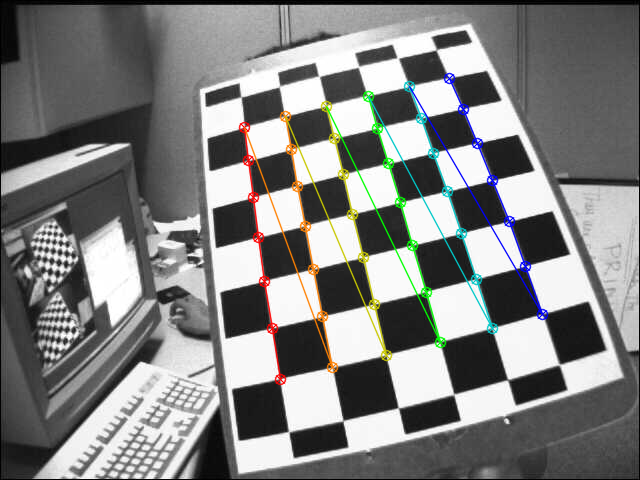

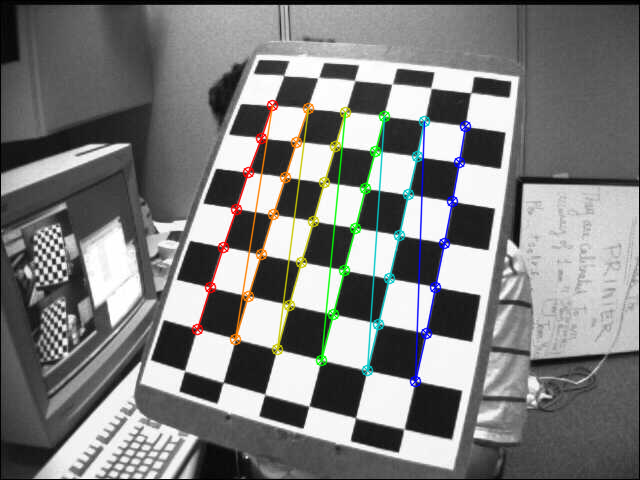

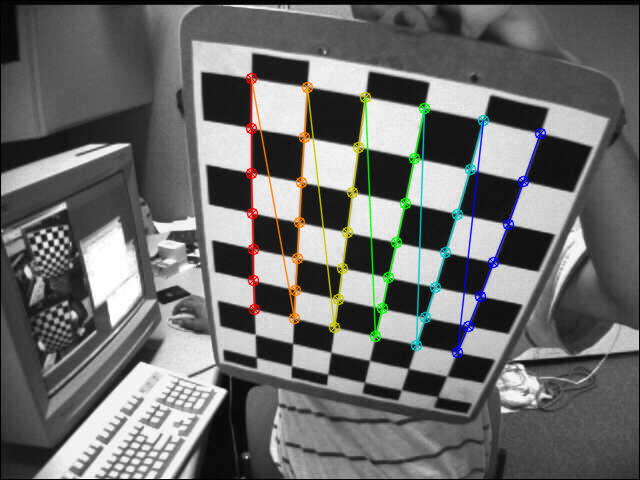

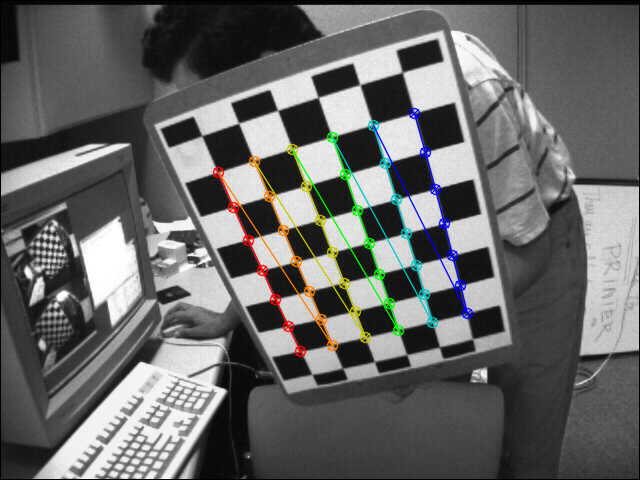

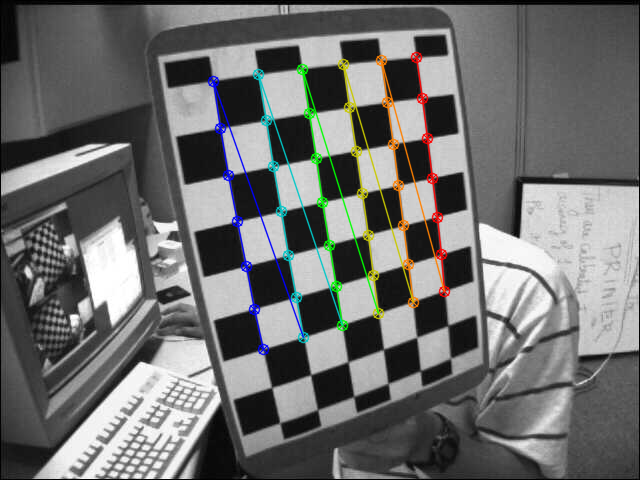

...

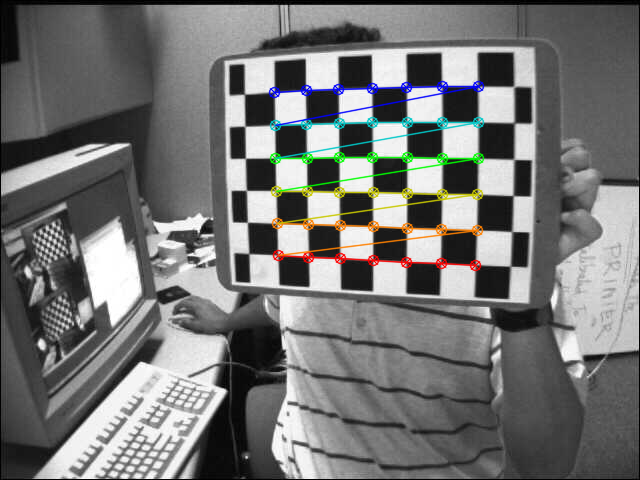

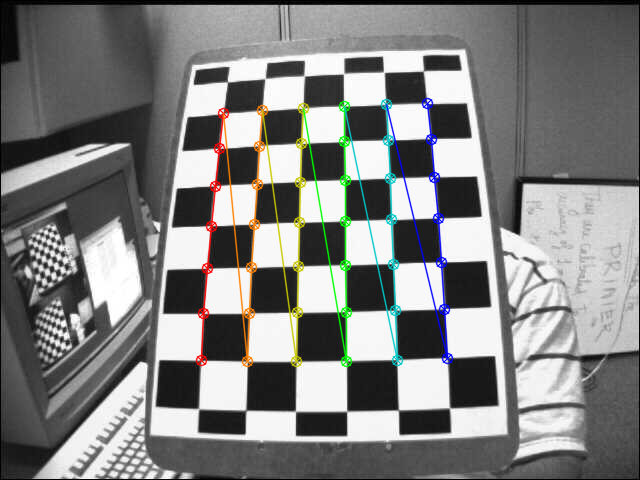

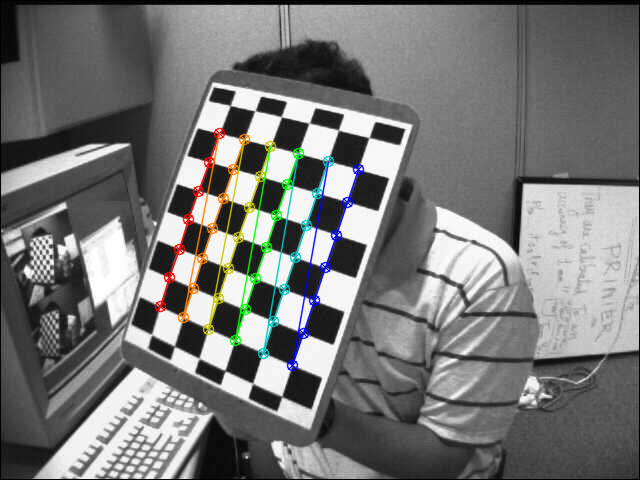

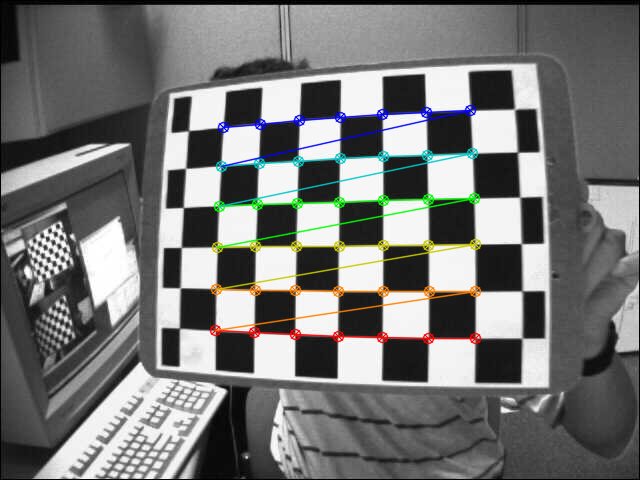

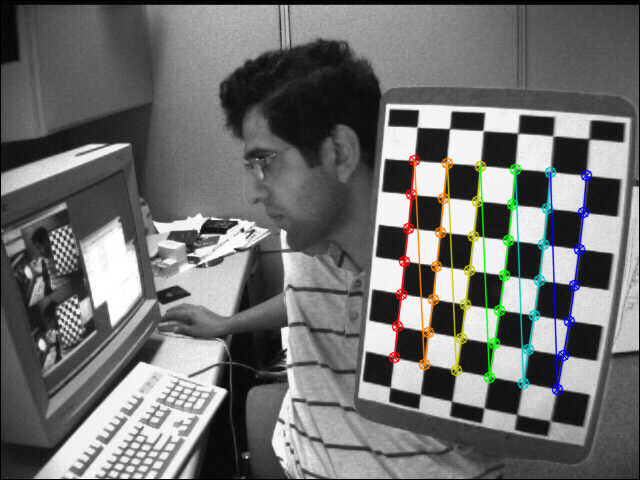

In [ ]:
# COPY THE TUTORIAL CODE HERE
# Note that you may have to comment out some lines (e.g., cv.destroyAllWindows())

# You should get something like the following images
